# Only For Google Colab

In [ ]:
!nvidia-smi

In [ ]:
# Put the cropped images in a zip file and upload to colab
!unzip ../cropped_images.zip

In [ ]:
%pip install xmltodict
%pip install tensorflow_addons
%pip install tensorflow --upgrade

# For Anywhere

In [1]:
import cv2
import matplotlib.image as img
import matplotlib.pyplot as plt
import numpy as np
import os
import random
import tensorflow as tf
import tensorflow_addons as tfa
import xmltodict

from tensorflow import keras

tf.config.list_physical_devices()

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'),
 PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

# Look at images and their keypoints

All images of shells should be cropped and in a train, val, test folders and keypoint annotations should be in a folder called `keypoint_annotations_10-29-2022`.

In [2]:
train_dir = os.path.join('..', 'train')
val_dir = os.path.join('..', 'val')
test_dir = os.path.join('..', 'test')
xml_path = os.path.join('..', 'keypoint_annotations_10-29-2022.xml')

In [3]:
# Get shell keypoints.
def get_keypoints(xml_path, image_name):
    """
    Parses keypoints from xml for a specific image.

    Arguments:
        xml_path: path to the xml created by CVAT.
        image_name: name of the image annotated by CVAT.

    Returns:
        tuple: ([corners that make the scutes perimeter], [the centers of the three scutes]).
    """

    with open(xml_path, 'r') as f:
        xml_dict = xmltodict.parse(f.read())
        centers = []
        corners = []
        for img_annotation in xml_dict['annotations']['image']:
            if image_name == img_annotation['@name']:
                if len(img_annotation['points']) > 1:
                    for label in img_annotation['points']:
                        if label['@label'] == 'centers':
                            for point in label['@points'].split(";"):
                                centers.append(tuple(round(float(coord ))for coord in point.split(',')))
                        if label['@label'] == 'corners':
                            for point in label['@points'].split(";"):
                                corners.append(tuple(round(float(coord ))for coord in point.split(',')))

    return corners, centers

In [4]:
# Get image names and shell keypoints.
image_paths = {
    train_dir: [],
    val_dir: [],
    test_dir: [],
}

keypoints = {
    train_dir: [],
    val_dir: [],
    test_dir: [],
}

for img_dir, v in image_paths.items():
    for root, dirs, files in os.walk(img_dir):
        for file in files:
            if os.path.splitext(file)[1] == '.jpg':
                image_paths[img_dir].append(os.path.join(root, file))
                keypoints[img_dir].append(get_keypoints(xml_path, file))

print(f'length of training images: {len(image_paths[train_dir])}')
print(f'length of trainging keypoints: {len(keypoints[train_dir])}')
print()
print(f'length of training images: {len(image_paths[val_dir])}')
print(f'length of trainging keypoints: {len(keypoints[val_dir])}')
print()

print(f'length of training images: {len(image_paths[test_dir])}')
print(f'length of trainging keypoints: {len(keypoints[test_dir])}')

length of training images: 130
length of trainging keypoints: 130

length of training images: 37
length of trainging keypoints: 37

length of training images: 19
length of trainging keypoints: 19


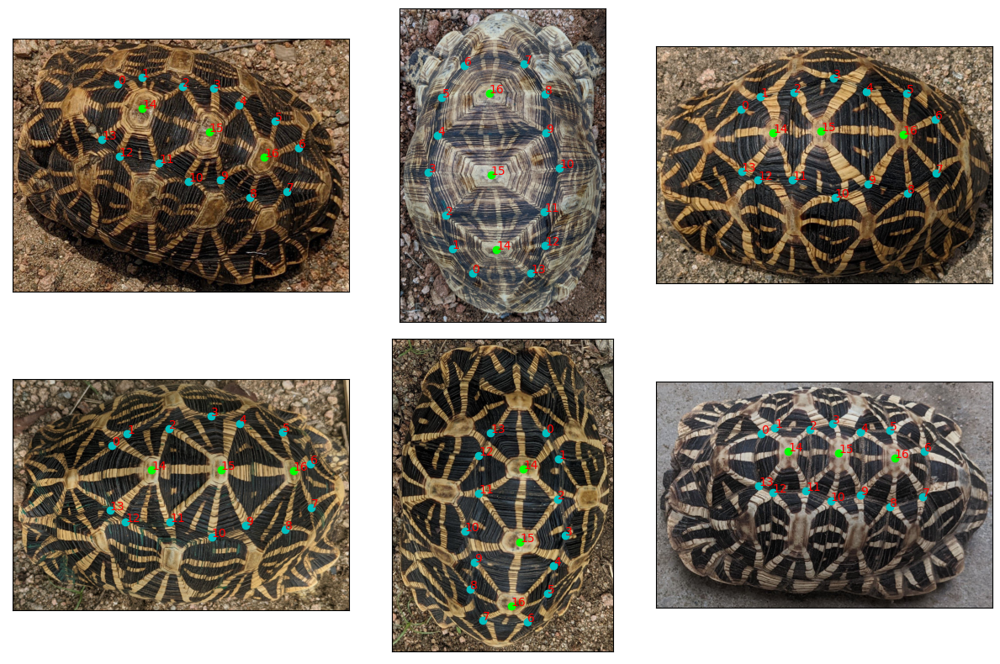

In [5]:
# Plot a sample of training images and their keypoints.
fig = plt.figure(figsize=(12, 8))
axes = fig.subplots(2, 3)
flatten_axes = axes.flatten()
random_image_idx = random.sample(range(len(image_paths[train_dir])), k=len(flatten_axes))

for e, i in enumerate(random_image_idx):

    # Read and plot image.
    image = img.imread(image_paths[train_dir][i])
    flatten_axes[e].imshow(image)
    flatten_axes[e].get_xaxis().set_visible(False)
    flatten_axes[e].get_yaxis().set_visible(False)

    # Plot keypoints.
    points = np.concatenate(keypoints[train_dir][i])
    x, y  = points[:, 0], points[:, 1]
    flatten_axes[e].scatter(x[:-3], y[:-3], c='c')
    flatten_axes[e].scatter(x[-3:], y[-3:], c='lime')

    # Numerate the points.
    for point_idx, (x_i, y_i) in enumerate(zip(x, y)):
        flatten_axes[e].text(x_i, y_i, point_idx, c='r')

plt.tight_layout()
plt.show()

# Create TFDataset

In [6]:
train_flat_keypoints = [list(np.concatenate([corners, centers]).flatten()) for corners, centers in keypoints[train_dir]]
val_flat_keypoints = [list(np.concatenate([corners, centers]).flatten()) for corners, centers in keypoints[val_dir]]
test_flat_keypoints = [list(np.concatenate([corners, centers]).flatten()) for corners, centers in keypoints[test_dir]]

In [7]:
train_tfdatasets_dir = ('train_tfdatasets')
val_tfdatasets_dir = ('val_tfdatasets')
test_tfdatasets_dir = ('test_tfdatasets')

for tfdatasets_dir in [train_tfdatasets_dir, val_tfdatasets_dir, test_tfdatasets_dir]:
    if not os.path.exists(tfdatasets_dir):
        os.makedirs(tfdatasets_dir)

In [8]:
def create_example(image, path, keypoints):
    feature = {
        "image": tf.train.Feature(bytes_list=tf.train.BytesList(value=[tf.io.encode_jpeg(image).numpy()])),
        "path": tf.train.Feature(bytes_list=tf.train.BytesList(value=[path.encode()])),
        "keypoints": tf.train.Feature(float_list=tf.train.FloatList(value=keypoints))
    }
    return tf.train.Example(features=tf.train.Features(feature=feature))


def create_records(image_paths, flat_keypoints, tfdatasets_dir, num_samples):
    num_tfrecords = -1* (-len(image_paths) // num_samples)
    records = []
    for tfrec_num in range(num_tfrecords):
        samples = image_paths[tfrec_num*num_samples : num_samples+num_samples*tfrec_num]
        targets = flat_keypoints[tfrec_num*num_samples : num_samples+num_samples*tfrec_num]

        file_name = tfdatasets_dir + "/file_%.2i-%i.tfrec" % (tfrec_num, len(samples))
        records.append(file_name)
        with tf.io.TFRecordWriter(file_name) as writer:
            for sample, target in zip(samples, targets):
                image_path = sample
                image = tf.io.decode_jpeg(tf.io.read_file(image_path))
                example = create_example(image, image_path, target)
                writer.write(example.SerializeToString())
                
    return records

In [9]:
num_samples = 44
train_records = create_records(image_paths[train_dir], train_flat_keypoints, train_tfdatasets_dir, num_samples)
val_records = create_records(image_paths[val_dir], val_flat_keypoints, val_tfdatasets_dir, num_samples)
test_records = create_records(image_paths[test_dir], test_flat_keypoints, test_tfdatasets_dir, num_samples)

Metal device set to: Apple M1 Pro


2022-11-12 12:55:07.840360: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2022-11-12 12:55:07.840814: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [10]:
def parse_tfrecord_fn(example):
    feature_description = {
        "image": tf.io.FixedLenFeature([], tf.string),
        "path": tf.io.FixedLenFeature([], tf.string),
        "keypoints": tf.io.VarLenFeature(tf.float32),

    }
    example = tf.io.parse_single_example(example, feature_description)
    example["image"] = tf.io.decode_jpeg(example["image"], channels=3)
    example["keypoints"] = tf.sparse.to_dense(example["keypoints"])
    return example["image"], example["keypoints"]


In [11]:
train_records

['train_tfdatasets/file_00-44.tfrec',
 'train_tfdatasets/file_01-44.tfrec',
 'train_tfdatasets/file_02-42.tfrec']

In [12]:
raw_dataset = tf.data.TFRecordDataset(train_records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.padded_batch(2)

In [13]:
batches = iter(train_dataset)

2022-11-12 12:55:14.211965: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


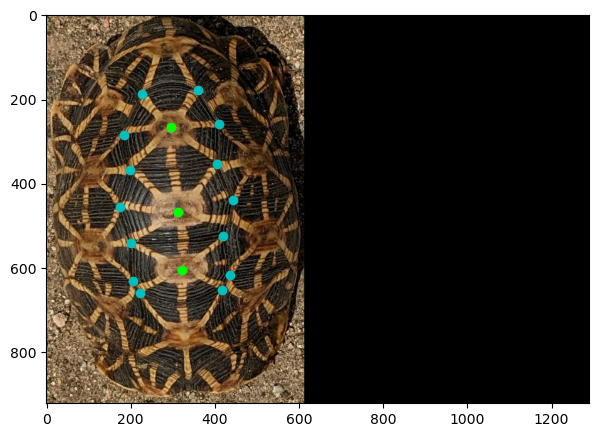

In [14]:
batch = next(batches)
image = batch[0][0]
points = batch[1][0]

plt.figure(figsize=(7, 7))
plt.imshow(image)


x = []
y = []
for coord in zip(points[::2], points[1::2]):
    x.append(coord[0])
    y.append(coord[1])
    
plt.scatter(x[:-3], y[:-3], c='c')
plt.scatter(x[-3:], y[-3:], c='lime')

plt.show()

# Resize images

We resize images to be a square.

In [15]:
def resize_images_keypoints(image, keypoints, size=256):
        resized_img = tf.image.resize(image, (size, size), method='nearest')
        x, y = keypoints[::2], keypoints[1::2]
        resized_trgts = [1, 2, 3, 4]
        image_shape = tf.cast(tf.shape(image)[:2], dtype=tf.int32)
        resized_x = tf.multiply(x, tf.cast(tf.divide(size, image_shape[1]), tf.float32))
        resized_y = tf.multiply(y, tf.cast(tf.divide(size, image_shape[0]), tf.float32))
        
    
        resized_trgts = tf.reshape(tf.stack((resized_x, resized_y), axis=-1), shape=(-1, 34))[0]
        return resized_img, resized_trgts

In [16]:
IMAGE_SIZE = 224
raw_dataset = tf.data.TFRecordDataset(train_records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, 640))
train_dataset = train_dataset.shuffle(64)
train_dataset = train_dataset.padded_batch(16)

In [17]:
def plot_images_keypoints(images, keypoints, rows=3, cols=5):
    fig = plt.figure(figsize=(3*cols, 3*rows))
    axes = fig.subplots(rows, cols)
    flatten_axes = axes.flatten()

    for i, image in enumerate(images):
        
        if i >= rows*cols:
            break
        
        
        # Read image.
        flatten_axes[i].imshow(image)

        # Plot keypoints.
        x = []
        y = []
        for coord in zip(keypoints[i, ::2], keypoints[i, 1::2]):
            x.append(coord[0])
            y.append(coord[1])
            
        flatten_axes[i].scatter(x[:-3], y[:-3], c='c')
        flatten_axes[i].scatter(x[-3:], y[-3:], c='lime')
        flatten_axes[i].get_xaxis().set_visible(False)
        flatten_axes[i].get_yaxis().set_visible(False)

    plt.show()

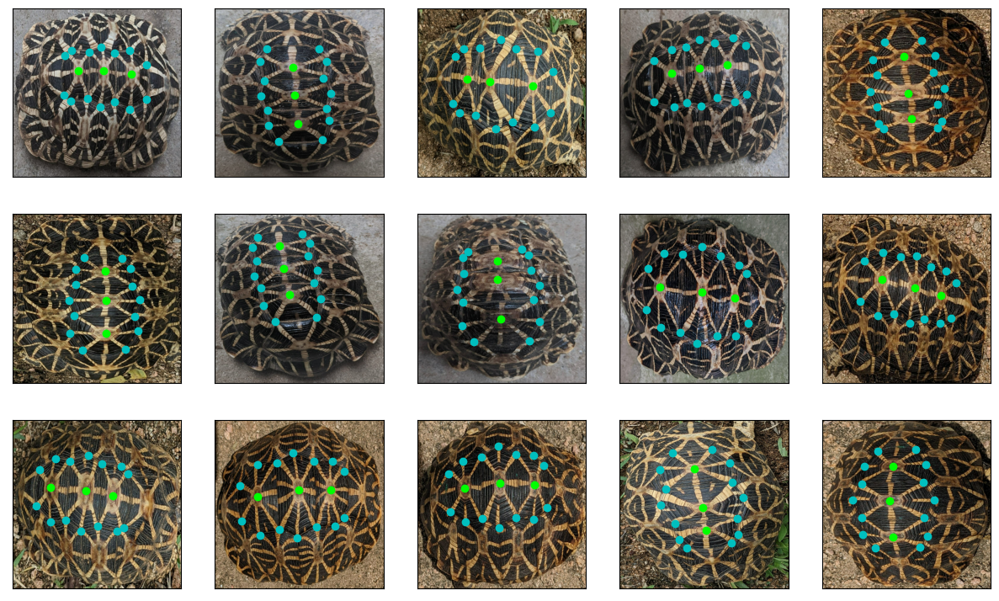

In [18]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

# Augmentation

## Flip

In [19]:
def flip_images_keypoints(image, keypoints):
    if tf.random.uniform(()) > 0.5:
        image = tf.image.flip_left_right(image)
        image_shape = tf.cast(tf.shape(image)[:2], tf.float32)
        keypoints = tf.reshape(tf.stack([image_shape[1] - keypoints[::2], keypoints[1::2]], axis=-1), shape=(-1,34))[0]
    return image, keypoints

In [20]:
IMAGE_SIZE = 224
raw_dataset = tf.data.TFRecordDataset(train_records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, 640))
train_dataset = train_dataset.map(flip_images_keypoints)
train_dataset = train_dataset.shuffle(64)
train_dataset = train_dataset.batch(16)

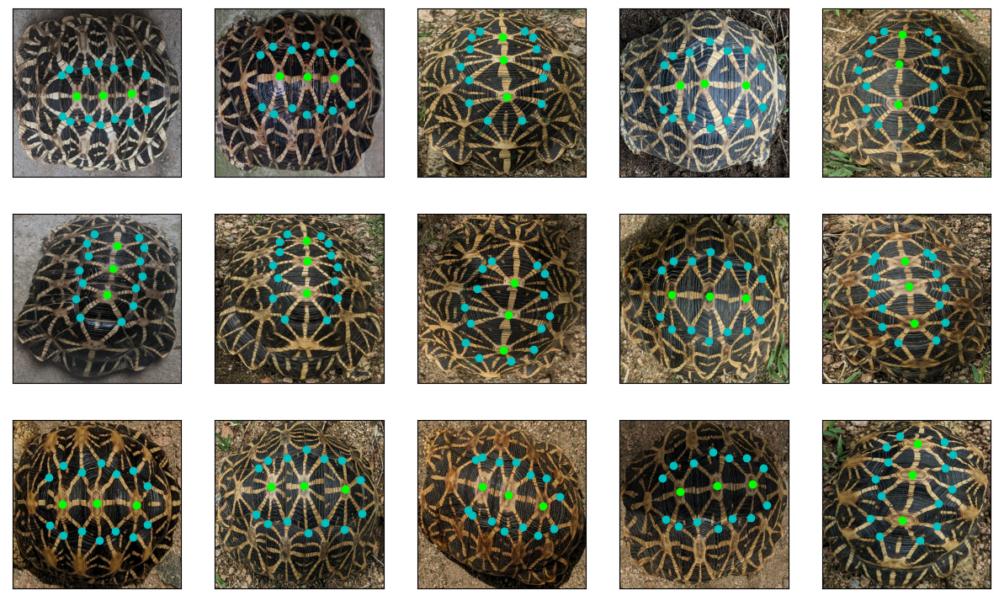

In [21]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

## Rotate

In [22]:
def rotate_images_keypoints(images, keypoints):
    keypoints = keypoints

    angle = tf.random.uniform((), maxval= 359)
    radians = angle * (np.pi/180)
    
    random_number = tf.random.uniform(())
    if  0 <= random_number and random_number < 0.33333:
        image = tfa.image.rotate(images, radians, fill_mode='wrap')
    elif 0.33333 <= random_number and random_number < 0.66666:
        image = tfa.image.rotate(images, radians, fill_mode="reflect")
    else:
        image = tfa.image.rotate(images, radians)

    image_shape = tf.shape(image)[:2]

    radians = angle * (np.pi/180)
    angle_cos, angle_sin = tf.math.cos(radians), -tf.math.sin(radians)
    half_width = tf.cast(image_shape[1]/2, dtype=tf.float32)
    half_height = tf.cast(image_shape[0]/2, dtype=tf.float32)

    x = keypoints[::2] - half_width
    y = keypoints[1::2] - half_height

    rot_x = (x*angle_cos) - (y*angle_sin)
    rot_y = (y*angle_cos) + (x*angle_sin)
    rot_x = rot_x+half_width
    rot_y = rot_y+half_height
    
    keypoints = tf.reshape(tf.stack([rot_x, rot_y], axis=-1), shape=(-1,34))[0]
    
    return image, keypoints

In [23]:
IMAGE_SIZE = 224
BATCH_SIZE = 16
raw_dataset = tf.data.TFRecordDataset(train_records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE))
train_dataset = train_dataset.map(rotate_images_keypoints)
train_dataset = train_dataset.batch(BATCH_SIZE)

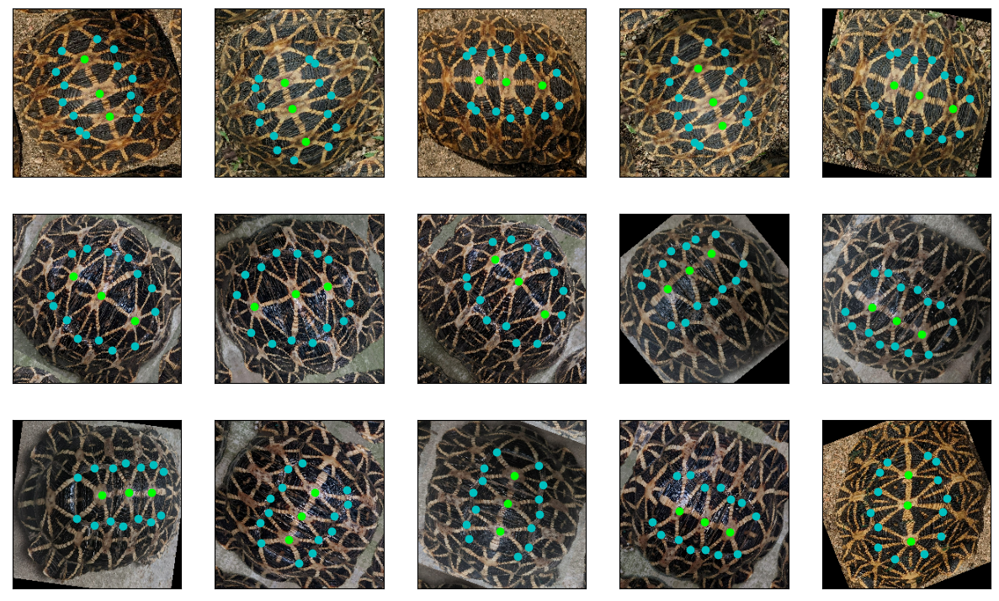

In [24]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

## Shift

In [25]:
def shift_images_keypoints(image, keypoints, max_pixels=15):
    keypoints = tf.cast(keypoints, tf.float32)
    image_shape = tf.cast(tf.shape(image)[:2], tf.float32)


    translation = tf.random.uniform([2], minval=-max_pixels, maxval=max_pixels)
    
    x = keypoints[::2] + translation[0]
    y = keypoints[1::2] + translation[1]

    
    if tf.reduce_all(x < image_shape[1]) and tf.reduce_all(y < image_shape[0]):
        random_number = tf.random.uniform(())
        if  0 <= random_number and random_number < 0.33333:
            image = tfa.image.translate(image, translation, fill_mode='wrap')
        elif 0.33333 <= random_number and random_number < 0.66666:
            image = tfa.image.translate(image, translation, fill_mode='reflect')
        else:
            image = tfa.image.translate(image, translation)
        keypoints = tf.reshape(tf.stack([x, y], axis=-1), shape=(-1,34))[0]
        
    return image, keypoints
    

In [26]:
IMAGE_SIZE = 224
BATCH_SIZE = 16
MAX_SHIFT = 20
raw_dataset = tf.data.TFRecordDataset(train_records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE))
train_dataset = train_dataset.map(lambda x, y: shift_images_keypoints(x, y, MAX_SHIFT))
train_dataset = train_dataset.batch(BATCH_SIZE)

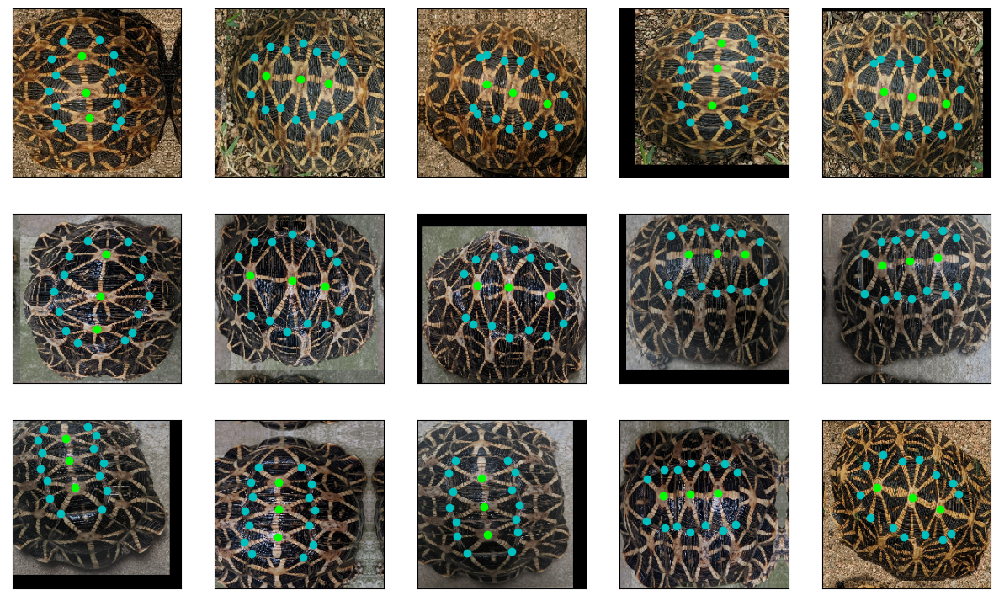

In [27]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

## Brightness

In [28]:
IMAGE_SIZE = 224
BATCH_SIZE = 16
MAX_BRIGHTNESS_DELTA = 0.3
raw_dataset = tf.data.TFRecordDataset(train_records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_brightness(x, MAX_BRIGHTNESS_DELTA), y))
train_dataset = train_dataset.batch(BATCH_SIZE)

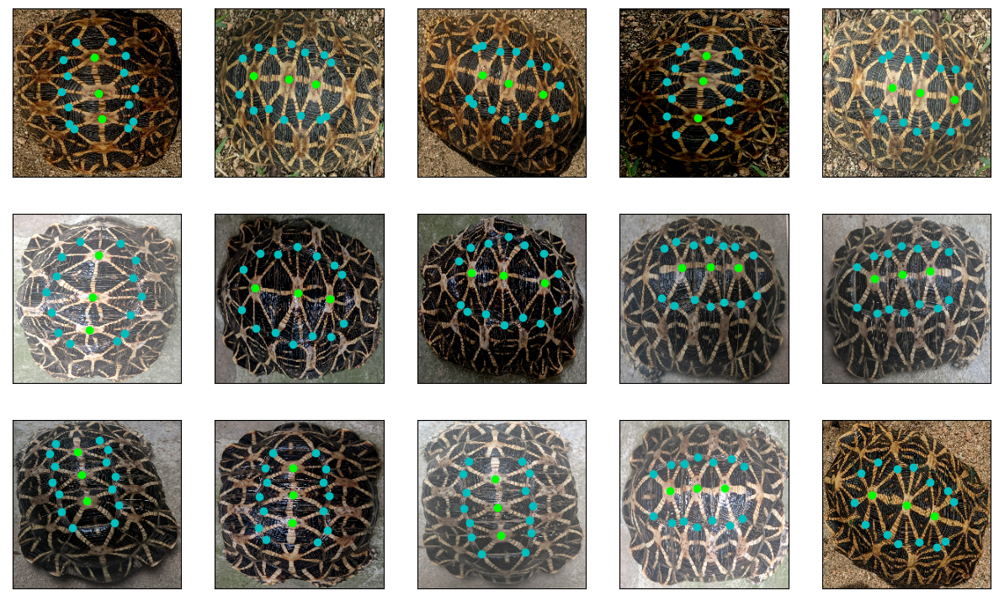

In [29]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

## Contrast

In [30]:
IMAGE_SIZE = 224
BATCH_SIZE = 16
MIN_CONTRAST = 0.5
MAX_CONTRAST = 3
raw_dataset = tf.data.TFRecordDataset(train_records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_contrast(x, MIN_CONTRAST, MAX_CONTRAST), y))
train_dataset = train_dataset.batch(BATCH_SIZE)

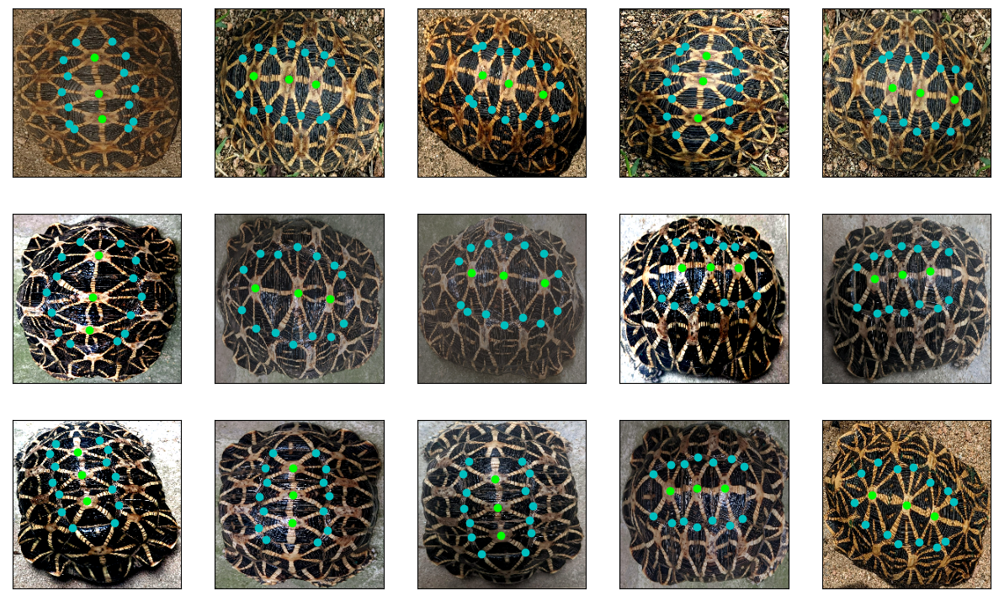

In [31]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

## Hue

In [32]:
IMAGE_SIZE = 224
BATCH_SIZE = 16
MAX_HUE_DELTA = 0.1
raw_dataset = tf.data.TFRecordDataset(train_records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_hue(x, MAX_HUE_DELTA), y))
train_dataset = train_dataset.batch(BATCH_SIZE)

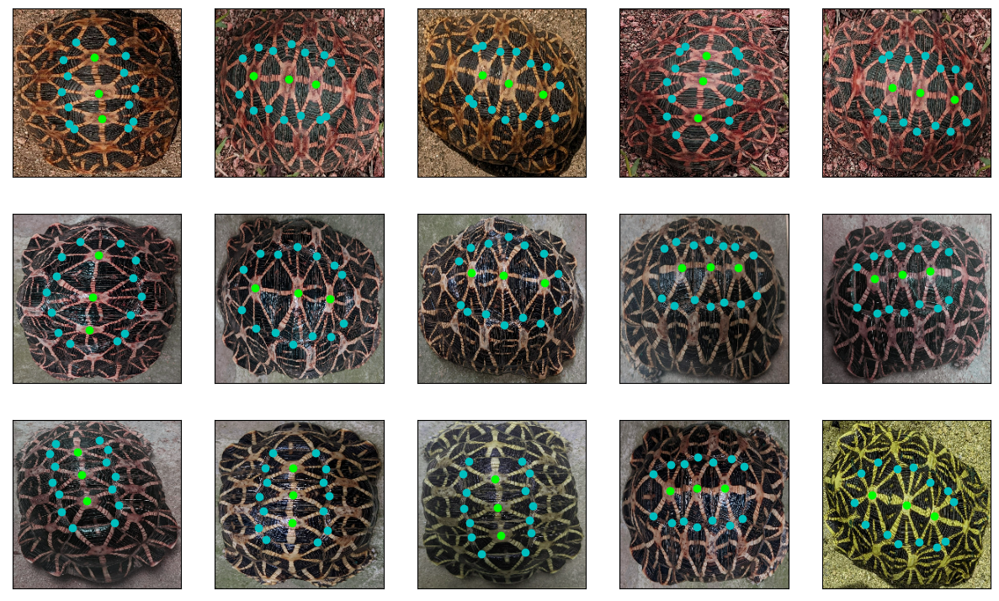

In [33]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

## JPEG Quality

In [34]:
IMAGE_SIZE = 224
BATCH_SIZE = 16
MIN_QUALITY = 25
MAX_QUALITY = 100
raw_dataset = tf.data.TFRecordDataset(train_records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_jpeg_quality(x, MIN_QUALITY, MAX_QUALITY), y))
train_dataset = train_dataset.batch(BATCH_SIZE)

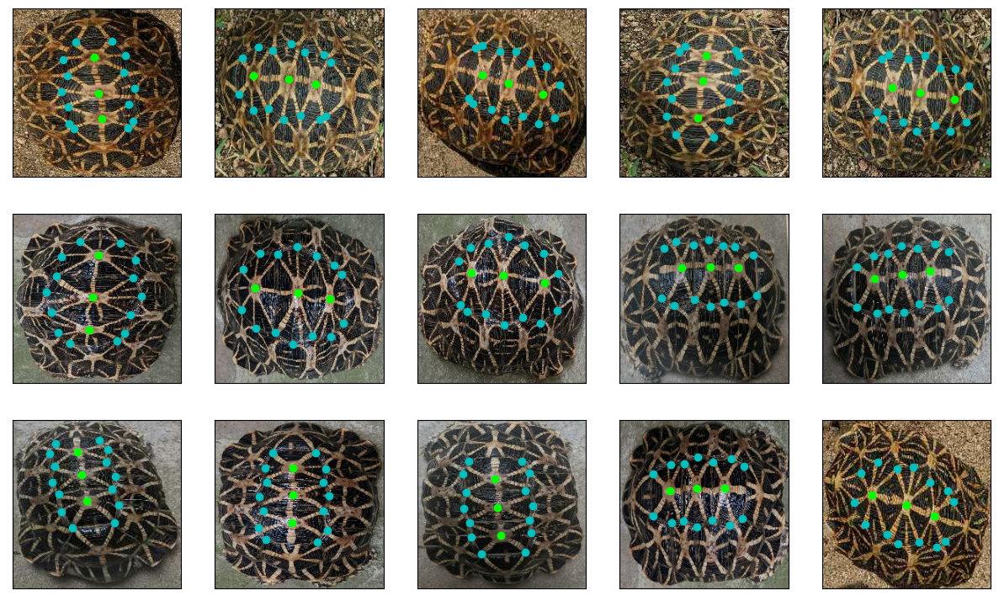

In [35]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

## Saturation

In [36]:
IMAGE_SIZE = 224
BATCH_SIZE = 16
MIN_SATURATION = 0.2
MAX_SATURATION = 2
raw_dataset = tf.data.TFRecordDataset(train_records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_saturation(x, MIN_SATURATION, MAX_SATURATION), y))
train_dataset = train_dataset.batch(BATCH_SIZE)

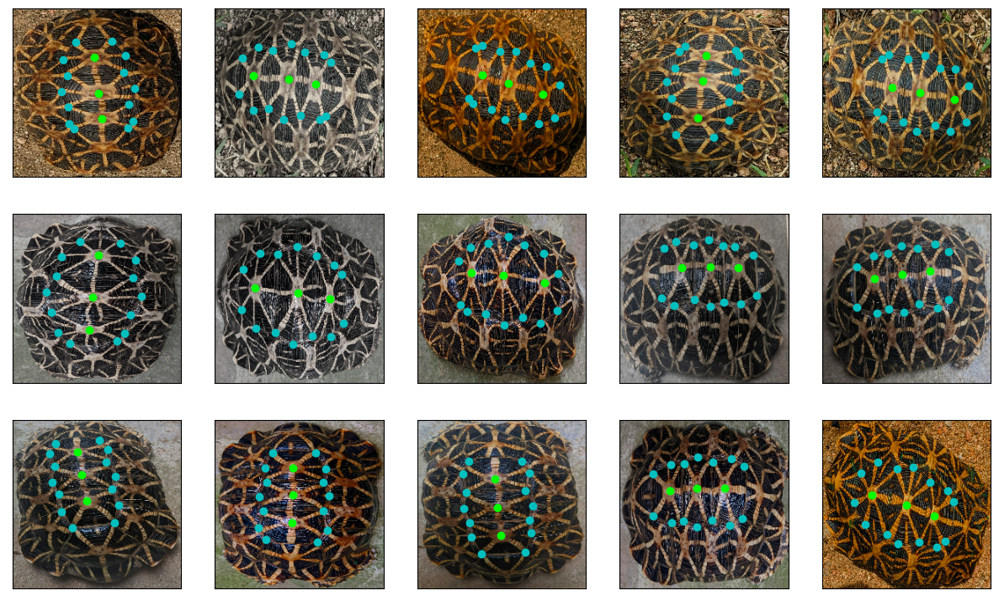

In [37]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

# All Together Now

In [38]:
IMAGE_SIZE = 224
BATCH_SIZE = 32
VAL_SPLIT = 0.11
MAX_SHIFT = 20
MAX_BRIGHTNESS_DELTA = 0.2
MIN_CONTRAST = 0.5
MAX_CONTRAST = 2
MAX_HUE_DELTA = 0.1
MIN_QUALITY = 25
MAX_QUALITY = 100
MIN_SATURATION = 0.3
MAX_SATURATION = 1.7

autotune = tf.data.AUTOTUNE
raw_train_dataset = tf.data.TFRecordDataset(train_records)
raw_val_dataset = tf.data.TFRecordDataset(val_records)
raw_test_dataset = tf.data.TFRecordDataset(test_records)

train_dataset = raw_train_dataset.map(parse_tfrecord_fn, num_parallel_calls=autotune)
val_dataset = raw_val_dataset.map(parse_tfrecord_fn, num_parallel_calls=autotune)
test_dataset = raw_test_dataset.map(parse_tfrecord_fn, num_parallel_calls=autotune)

# Resize
train_dataset = train_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE), num_parallel_calls=autotune)
val_dataset = val_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE), num_parallel_calls=autotune)
test_dataset = test_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE), num_parallel_calls=autotune)


#  Multiply dataset by 2^n.
n = 6
for i in range(n):
    train_dataset = train_dataset.concatenate(train_dataset)

# Augmentations
train_dataset = train_dataset.map(flip_images_keypoints, num_parallel_calls=autotune)
train_dataset = train_dataset.map(rotate_images_keypoints, num_parallel_calls=autotune)
train_dataset = train_dataset.map(lambda x, y: shift_images_keypoints(x, y, MAX_SHIFT))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_brightness(x, MAX_BRIGHTNESS_DELTA), y))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_contrast(x, MIN_CONTRAST, MAX_CONTRAST), y))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_hue(x, MAX_HUE_DELTA), y))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_jpeg_quality(x, MIN_QUALITY, MAX_QUALITY), y))
train_dataset = train_dataset.map(lambda x, y: (tf.image.random_saturation(x, MIN_SATURATION, MAX_SATURATION), y))

train_dataset = train_dataset.shuffle(8*BATCH_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)
train_dataset = train_dataset.prefetch(autotune)

val_dataset = val_dataset.batch(BATCH_SIZE)
val_dataset = val_dataset.prefetch(autotune)

test_dataset = test_dataset.batch(BATCH_SIZE)
test_dataset = test_dataset.prefetch(autotune)

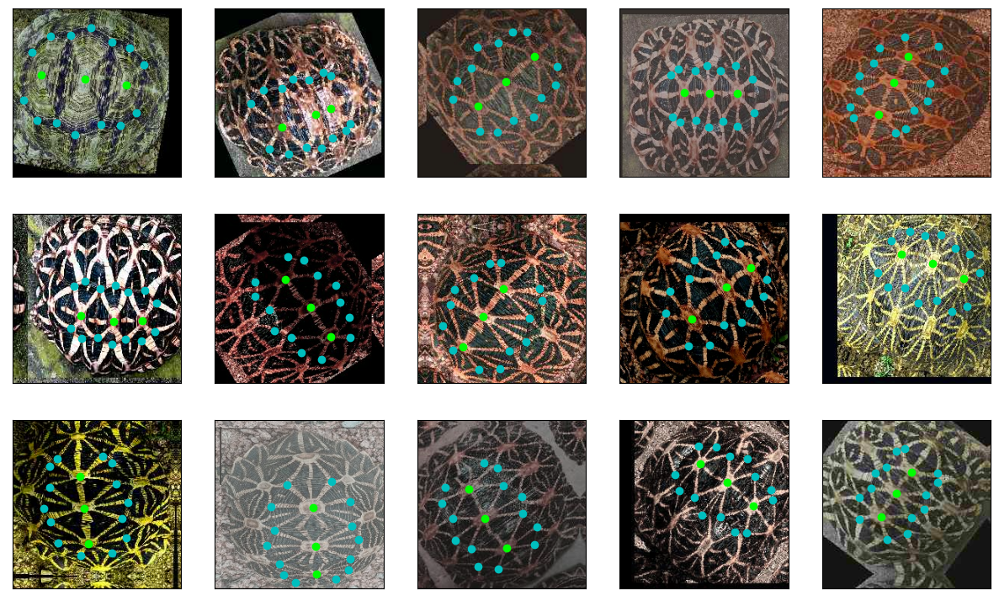

In [39]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

In [46]:
number_of_steps = train_dataset.cardinality().numpy()
if number_of_steps == -2:
    number_of_steps = len(list(iter(train_dataset)))
number_of_steps

260

# Model

In [47]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau, LearningRateScheduler

# Define callbacks
earlystop = EarlyStopping(monitor = 'val_loss', 
               patience = 64,
               mode = 'min',
               baseline=None,
               restore_best_weights=True)

In [48]:
base_model = keras.applications.MobileNetV2(
    include_top=False, pooling='avg', weights='imagenet', input_shape=(224, 224, 3)
    )

In [ ]:
# for layer in base_model.layers:
#     layer.trainable = False

In [49]:
# Want the last layer to be dense layer with 34 nodes
inputs = keras.Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3), name='input')
x = base_model(inputs)
x = keras.layers.Dropout(0.1)(x)
outputs = keras.layers.Dense(34)(x)
model = keras.Model(inputs, outputs)


model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input (InputLayer)          [(None, 224, 224, 3)]     0         
                                                                 
 mobilenetv2_1.00_224 (Funct  (None, 1280)             2257984   
 ional)                                                          
                                                                 
 dropout (Dropout)           (None, 1280)              0         
                                                                 
 dense (Dense)               (None, 34)                43554     
                                                                 
Total params: 2,301,538
Trainable params: 2,267,426
Non-trainable params: 34,112
_________________________________________________________________


In [50]:
# mobilenetv2 training.
LEARNING_RATE = 0.0001
warmup = keras.optimizers.schedules.PiecewiseConstantDecay([10*number_of_steps, 20*number_of_steps], [LEARNING_RATE/100, LEARNING_RATE/10, LEARNING_RATE])
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=warmup), 
    loss='mean_absolute_error',
    metrics=['mse'],
    )

history_high_lr=model.fit(train_dataset,
                  epochs=1000,
                  validation_data=val_dataset,
                  callbacks=[
                      earlystop,
                      tf.keras.callbacks.ModelCheckpoint(
                        filepath=os.path.join("high_lr", "mobilenetv2"),
                        monitor="val_loss",
                        save_best_only=True,
                        save_weights_only=True,
                        verbose=1,
                      )
                  ]
                )

model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE/10),
    loss='mean_absolute_error',
    metrics=['mse'],
    )

history_low_lr=model.fit(train_dataset,
                  epochs=1000,
                  validation_data=val_dataset,
                  callbacks=[
                      earlystop,
                      tf.keras.callbacks.ModelCheckpoint(
                        filepath=os.path.join("low_lr", "mobilenetv2"),
                        monitor="val_loss",
                        save_best_only=True,
                        save_weights_only=True,
                        verbose=1,
                      )
                  ]
                )

Epoch 1/1000


2022-11-12 12:59:22.893554: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


    260/Unknown - 58s 206ms/step - loss: 112.1909 - mse: 14499.8271

2022-11-12 13:00:19.615043: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: val_loss improved from inf to 106.08955, saving model to high_lr/mobilenetv2
260/260 [==============================] - 59s 213ms/step - loss: 112.1909 - mse: 14499.8271 - val_loss: 106.0895 - val_mse: 12874.6816
Epoch 2/1000
260/260 [==============================] - ETA: 0s - loss: 111.6150 - mse: 14369.3418
Epoch 2: val_loss improved from 106.08955 to 105.97171, saving model to high_lr/mobilenetv2
260/260 [==============================] - 57s 213ms/step - loss: 111.6150 - mse: 14369.3418 - val_loss: 105.9717 - val_mse: 12849.9229
Epoch 3/1000
260/260 [==============================] - ETA: 0s - loss: 111.5184 - mse: 14354.3203
Epoch 3: val_loss improved from 105.97171 to 105.81682, saving model to high_lr/mobilenetv2
260/260 [==============================] - 56s 211ms/step - loss: 111.5184 - mse: 14354.3203 - val_loss: 105.8168 - val_mse: 12815.9189
Epoch 4/1000
260/260 [==============================] - ETA: 0s - loss: 111.3130 - mse: 14305.0000
Epoch 4: val_loss improv

Epoch 27/1000
260/260 [==============================] - ETA: 0s - loss: 36.4071 - mse: 1848.1636
Epoch 27: val_loss improved from 35.32690 to 35.00723, saving model to high_lr/mobilenetv2
260/260 [==============================] - 57s 216ms/step - loss: 36.4071 - mse: 1848.1636 - val_loss: 35.0072 - val_mse: 1600.1160
Epoch 28/1000
260/260 [==============================] - ETA: 0s - loss: 36.1872 - mse: 1814.1494
Epoch 28: val_loss did not improve from 35.00723
260/260 [==============================] - 57s 212ms/step - loss: 36.1872 - mse: 1814.1494 - val_loss: 36.3607 - val_mse: 1830.2905
Epoch 29/1000
260/260 [==============================] - ETA: 0s - loss: 35.9638 - mse: 1789.9314
Epoch 29: val_loss did not improve from 35.00723
260/260 [==============================] - 57s 213ms/step - loss: 35.9638 - mse: 1789.9314 - val_loss: 37.0920 - val_mse: 1944.4163
Epoch 30/1000
260/260 [==============================] - ETA: 0s - loss: 35.7694 - mse: 1768.0667
Epoch 30: val_loss did 

Epoch 55/1000
260/260 [==============================] - ETA: 0s - loss: 4.2381 - mse: 29.9856
Epoch 55: val_loss improved from 7.30817 to 7.15719, saving model to high_lr/mobilenetv2
260/260 [==============================] - 54s 205ms/step - loss: 4.2381 - mse: 29.9856 - val_loss: 7.1572 - val_mse: 166.2928
Epoch 56/1000
260/260 [==============================] - ETA: 0s - loss: 4.1391 - mse: 28.8431
Epoch 56: val_loss did not improve from 7.15719
260/260 [==============================] - 54s 203ms/step - loss: 4.1391 - mse: 28.8431 - val_loss: 7.4713 - val_mse: 180.0560
Epoch 57/1000
260/260 [==============================] - ETA: 0s - loss: 4.0526 - mse: 27.6619
Epoch 57: val_loss did not improve from 7.15719
260/260 [==============================] - 54s 202ms/step - loss: 4.0526 - mse: 27.6619 - val_loss: 8.1298 - val_mse: 201.2212
Epoch 58/1000
260/260 [==============================] - ETA: 0s - loss: 3.9635 - mse: 26.5400
Epoch 58: val_loss improved from 7.15719 to 6.86779, s

260/260 [==============================] - 54s 202ms/step - loss: 2.4126 - mse: 9.6811 - val_loss: 6.8260 - val_mse: 198.3049
Epoch 85/1000
260/260 [==============================] - ETA: 0s - loss: 2.4523 - mse: 10.0902
Epoch 85: val_loss did not improve from 5.28999
260/260 [==============================] - 54s 203ms/step - loss: 2.4523 - mse: 10.0902 - val_loss: 6.4421 - val_mse: 172.9204
Epoch 86/1000
260/260 [==============================] - ETA: 0s - loss: 2.4319 - mse: 9.8707
Epoch 86: val_loss did not improve from 5.28999
260/260 [==============================] - 54s 203ms/step - loss: 2.4319 - mse: 9.8707 - val_loss: 5.5243 - val_mse: 150.7419
Epoch 87/1000
260/260 [==============================] - ETA: 0s - loss: 2.3990 - mse: 9.6715
Epoch 87: val_loss improved from 5.28999 to 5.25604, saving model to high_lr/mobilenetv2
260/260 [==============================] - 54s 205ms/step - loss: 2.3990 - mse: 9.6715 - val_loss: 5.2560 - val_mse: 128.8157
Epoch 88/1000
260/260 [====

Epoch 115/1000
260/260 [==============================] - ETA: 0s - loss: 1.9639 - mse: 6.4079
Epoch 115: val_loss did not improve from 5.21742
260/260 [==============================] - 54s 204ms/step - loss: 1.9639 - mse: 6.4079 - val_loss: 6.2401 - val_mse: 185.8036
Epoch 116/1000
260/260 [==============================] - ETA: 0s - loss: 1.9551 - mse: 6.3243
Epoch 116: val_loss did not improve from 5.21742
260/260 [==============================] - 55s 205ms/step - loss: 1.9551 - mse: 6.3243 - val_loss: 6.8420 - val_mse: 244.8199
Epoch 117/1000
260/260 [==============================] - ETA: 0s - loss: 1.9403 - mse: 6.2276
Epoch 117: val_loss did not improve from 5.21742
260/260 [==============================] - 54s 203ms/step - loss: 1.9403 - mse: 6.2276 - val_loss: 6.9692 - val_mse: 236.7198
Epoch 118/1000
260/260 [==============================] - ETA: 0s - loss: 1.9461 - mse: 6.2867
Epoch 118: val_loss did not improve from 5.21742
260/260 [==============================] - 56s

260/260 [==============================] - ETA: 0s - loss: 1.7451 - mse: 5.0633
Epoch 145: val_loss did not improve from 4.85498
260/260 [==============================] - 55s 205ms/step - loss: 1.7451 - mse: 5.0633 - val_loss: 5.6765 - val_mse: 178.9881
Epoch 146/1000
260/260 [==============================] - ETA: 0s - loss: 1.7449 - mse: 5.0628
Epoch 146: val_loss did not improve from 4.85498
260/260 [==============================] - 54s 203ms/step - loss: 1.7449 - mse: 5.0628 - val_loss: 6.9793 - val_mse: 228.6994
Epoch 147/1000
260/260 [==============================] - ETA: 0s - loss: 1.7250 - mse: 5.0265
Epoch 147: val_loss did not improve from 4.85498
260/260 [==============================] - 54s 203ms/step - loss: 1.7250 - mse: 5.0265 - val_loss: 5.8510 - val_mse: 171.1422
Epoch 148/1000
260/260 [==============================] - ETA: 0s - loss: 1.7194 - mse: 4.9329
Epoch 148: val_loss did not improve from 4.85498
260/260 [==============================] - 55s 206ms/step - l

260/260 [==============================] - 54s 203ms/step - loss: 1.5122 - mse: 3.8195 - val_loss: 6.6185 - val_mse: 260.9669
Epoch 176/1000
260/260 [==============================] - ETA: 0s - loss: 1.5008 - mse: 3.7584
Epoch 176: val_loss did not improve from 4.85498
260/260 [==============================] - 54s 203ms/step - loss: 1.5008 - mse: 3.7584 - val_loss: 7.1630 - val_mse: 292.2796
Epoch 177/1000
260/260 [==============================] - ETA: 0s - loss: 1.5089 - mse: 3.8204
Epoch 177: val_loss did not improve from 4.85498
260/260 [==============================] - 57s 214ms/step - loss: 1.5089 - mse: 3.8204 - val_loss: 6.9764 - val_mse: 250.7626
Epoch 178/1000
260/260 [==============================] - ETA: 0s - loss: 1.4898 - mse: 3.6998
Epoch 178: val_loss did not improve from 4.85498
260/260 [==============================] - 57s 213ms/step - loss: 1.4898 - mse: 3.6998 - val_loss: 7.1612 - val_mse: 261.4413
Epoch 179/1000
260/260 [==============================] - ETA: 0

2022-11-12 15:55:33.260105: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


    260/Unknown - 58s 210ms/step - loss: 1.6885 - mse: 4.8230

2022-11-12 15:56:30.288590: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: val_loss improved from inf to 4.80047, saving model to low_lr/mobilenetv2
260/260 [==============================] - 60s 217ms/step - loss: 1.6885 - mse: 4.8230 - val_loss: 4.8005 - val_mse: 135.2599
Epoch 2/1000
260/260 [==============================] - ETA: 0s - loss: 1.6638 - mse: 4.6617
Epoch 2: val_loss improved from 4.80047 to 4.67310, saving model to low_lr/mobilenetv2
260/260 [==============================] - 57s 215ms/step - loss: 1.6638 - mse: 4.6617 - val_loss: 4.6731 - val_mse: 130.5579
Epoch 3/1000
260/260 [==============================] - ETA: 0s - loss: 1.6542 - mse: 4.6145
Epoch 3: val_loss improved from 4.67310 to 4.59823, saving model to low_lr/mobilenetv2
260/260 [==============================] - 57s 214ms/step - loss: 1.6542 - mse: 4.6145 - val_loss: 4.5982 - val_mse: 125.8691
Epoch 4/1000
260/260 [==============================] - ETA: 0s - loss: 1.6563 - mse: 4.6548
Epoch 4: val_loss did not improve from 4.59823
260/260 [=============================

Epoch 32/1000
260/260 [==============================] - ETA: 0s - loss: 1.5901 - mse: 4.3143
Epoch 32: val_loss did not improve from 4.59823
260/260 [==============================] - 55s 206ms/step - loss: 1.5901 - mse: 4.3143 - val_loss: 5.2765 - val_mse: 149.6571
Epoch 33/1000
260/260 [==============================] - ETA: 0s - loss: 1.5878 - mse: 4.2928
Epoch 33: val_loss did not improve from 4.59823
260/260 [==============================] - 56s 212ms/step - loss: 1.5878 - mse: 4.2928 - val_loss: 5.2228 - val_mse: 146.4126
Epoch 34/1000
260/260 [==============================] - ETA: 0s - loss: 1.5830 - mse: 4.2723
Epoch 34: val_loss did not improve from 4.59823
260/260 [==============================] - 56s 211ms/step - loss: 1.5830 - mse: 4.2723 - val_loss: 5.3155 - val_mse: 153.6930
Epoch 35/1000
260/260 [==============================] - ETA: 0s - loss: 1.5795 - mse: 4.2488
Epoch 35: val_loss did not improve from 4.59823
260/260 [==============================] - 56s 211ms/s

Epoch 63/1000
260/260 [==============================] - ETA: 0s - loss: 1.5522 - mse: 4.1310
Epoch 63: val_loss did not improve from 4.59823
260/260 [==============================] - 53s 200ms/step - loss: 1.5522 - mse: 4.1310 - val_loss: 5.5606 - val_mse: 164.9826
Epoch 64/1000
260/260 [==============================] - ETA: 0s - loss: 1.5591 - mse: 4.1634
Epoch 64: val_loss did not improve from 4.59823
260/260 [==============================] - 54s 201ms/step - loss: 1.5591 - mse: 4.1634 - val_loss: 5.5511 - val_mse: 164.4030
Epoch 65/1000
260/260 [==============================] - ETA: 0s - loss: 1.5500 - mse: 4.1099
Epoch 65: val_loss did not improve from 4.59823
260/260 [==============================] - 53s 201ms/step - loss: 1.5500 - mse: 4.1099 - val_loss: 5.6688 - val_mse: 172.8573
Epoch 66/1000
260/260 [==============================] - ETA: 0s - loss: 1.5504 - mse: 4.1142
Epoch 66: val_loss did not improve from 4.59823
260/260 [==============================] - 53s 201ms/s

In [51]:
history_1 = history_high_lr.history.copy()
history_1["loss"].extend(history_low_lr.history['loss'])
history_1["val_loss"].extend(history_low_lr.history['val_loss'])

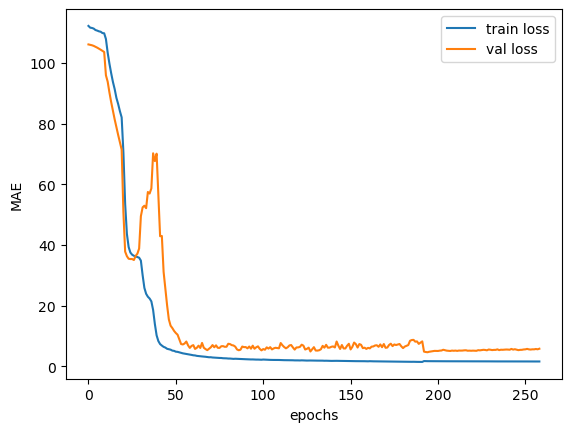

In [52]:
plt.plot(history_1['loss'], label="train loss")
plt.plot(history_1['val_loss'], label="val loss")
plt.ylabel('MAE')
plt.xlabel('epochs')
plt.legend()
plt.show()

# Evaluate

## Validation Set

2/2 [==============================] - 0s 112ms/step


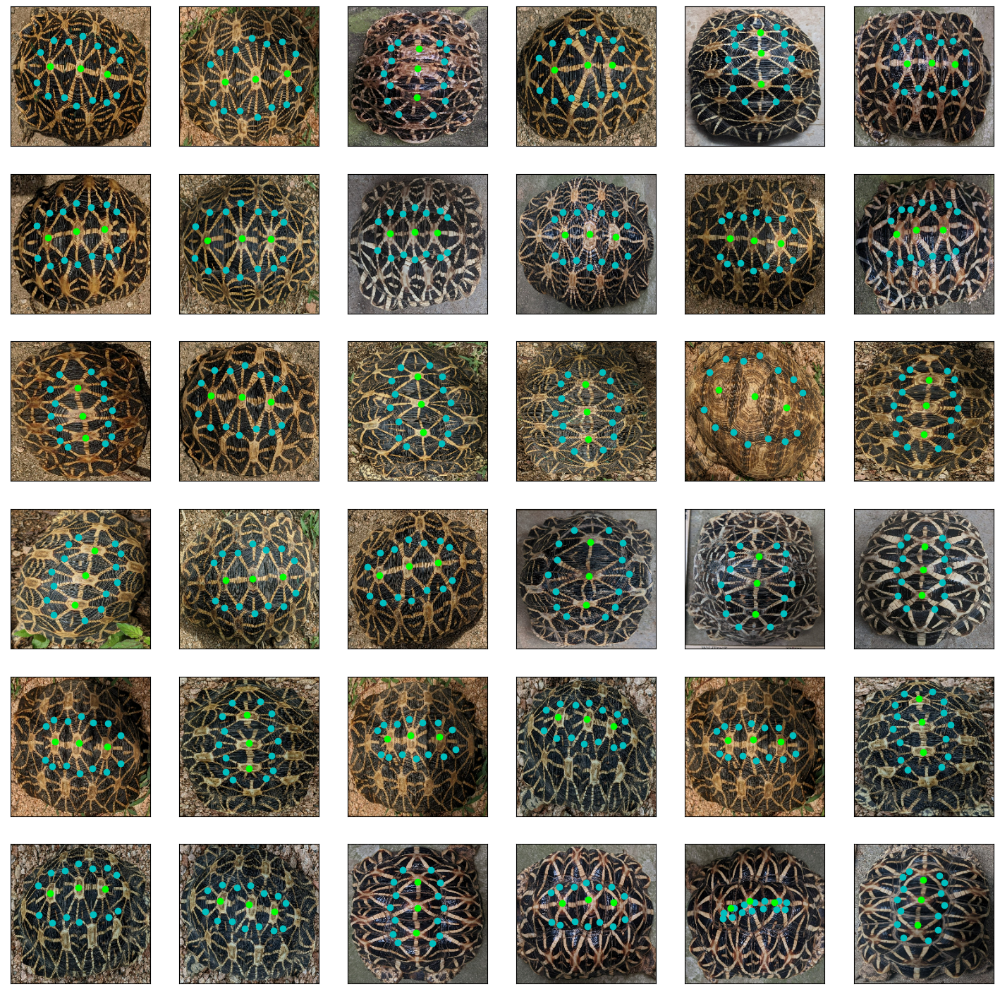

In [72]:
batches = iter(val_dataset)
images = next(batches)[0]
for batch in batches:
    images = tf.concat([images, batch[0]], axis=0)

pred = model.predict(images)
plot_images_keypoints(images, pred, 6, 6)

In [73]:
model.evaluate(val_dataset)

2/2 [==============================] - 0s 74ms/step - loss: 4.5982 - mse: 125.8691


[4.598226070404053, 125.86907958984375]

## Test Set

1/1 [==============================] - 0s 363ms/step


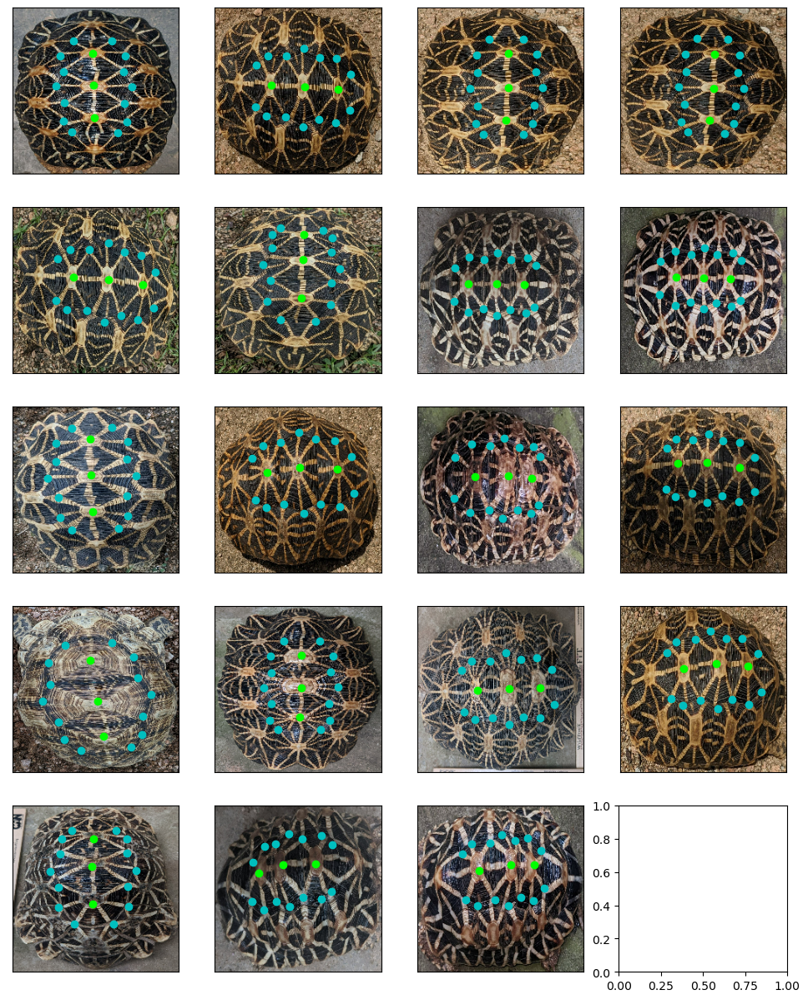

In [74]:
batches = iter(test_dataset)
images = next(batches)[0]

pred = model.predict(images)
plot_images_keypoints(images, pred, 5, 4)

In [83]:
model.evaluate(test_dataset)

1/1 [==============================] - 0s 289ms/step - loss: 2.1698 - mse: 11.7305


[2.1697921752929688, 11.730517387390137]

# Loading the model

In [85]:
saved_weights = tf.train.latest_checkpoint("low_lr")
model.load_weights(saved_weights)

In [82]:
saved_weights = tf.train.latest_checkpoint("mobilenetv2")
model.load_weights(saved_weights)

In [77]:
from shell_alignment.utils import align_scutes

TEMPLATE = np.float32([
    (0.725, 0.05), (0.95, 0.20),
    (0.725, 0.35), (0.95, 0.50),
    (0.725, 0.65), (0.95, 0.80),
    (0.725, 0.95), (0.275, 0.95),
    (0.05, 0.80),  (0.275, 0.65),
    (0.05, 0.50),  (0.275, 0.35),  
    (0.05, 0.20), (0.275, 0.05),
    (0.50, 0.20),
    (0.50, 0.50),
    (0.50, 0.80)])

1/1 [==============================] - 0s 23ms/step


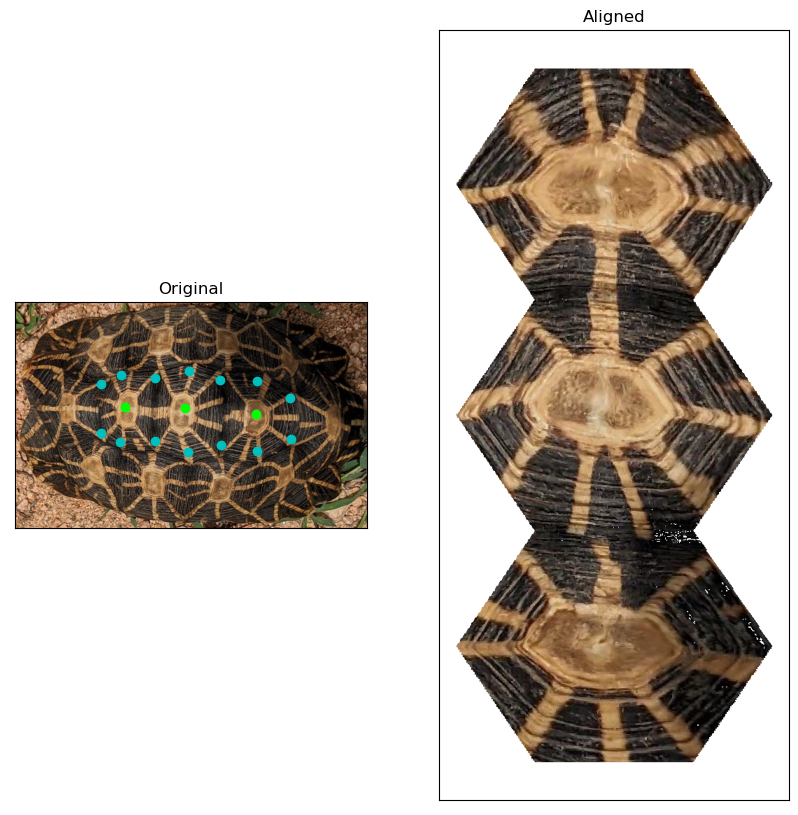

1/1 [==============================] - 0s 20ms/step


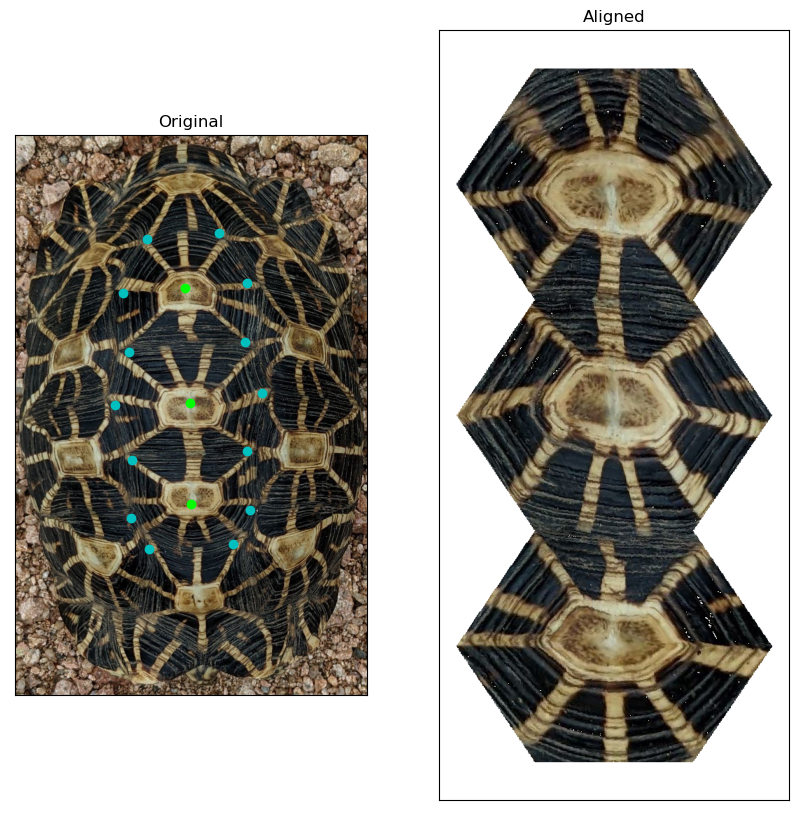

1/1 [==============================] - 0s 21ms/step


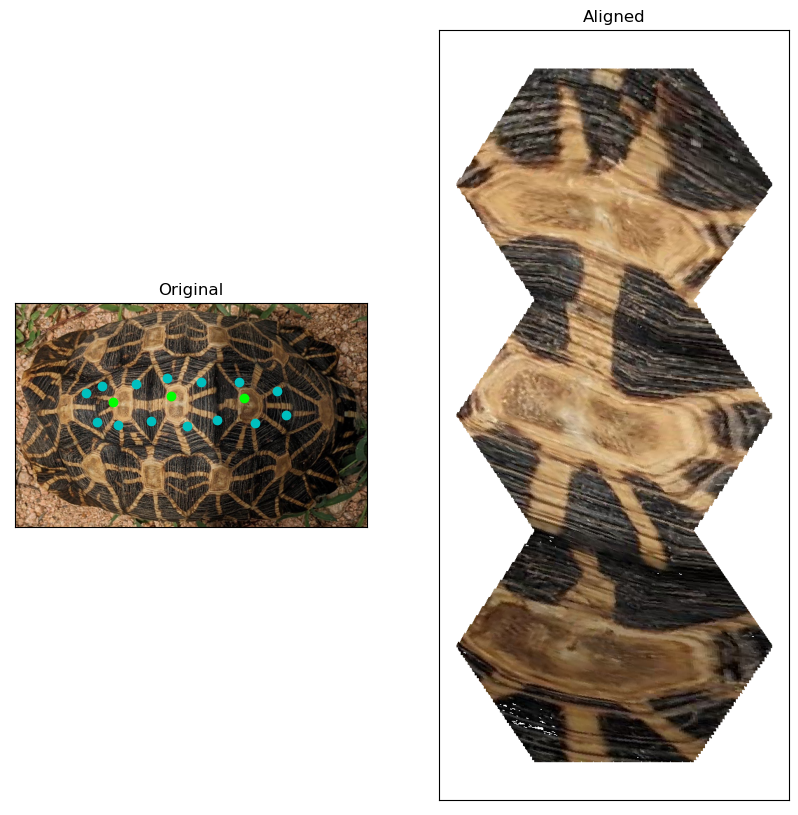

1/1 [==============================] - 0s 25ms/step


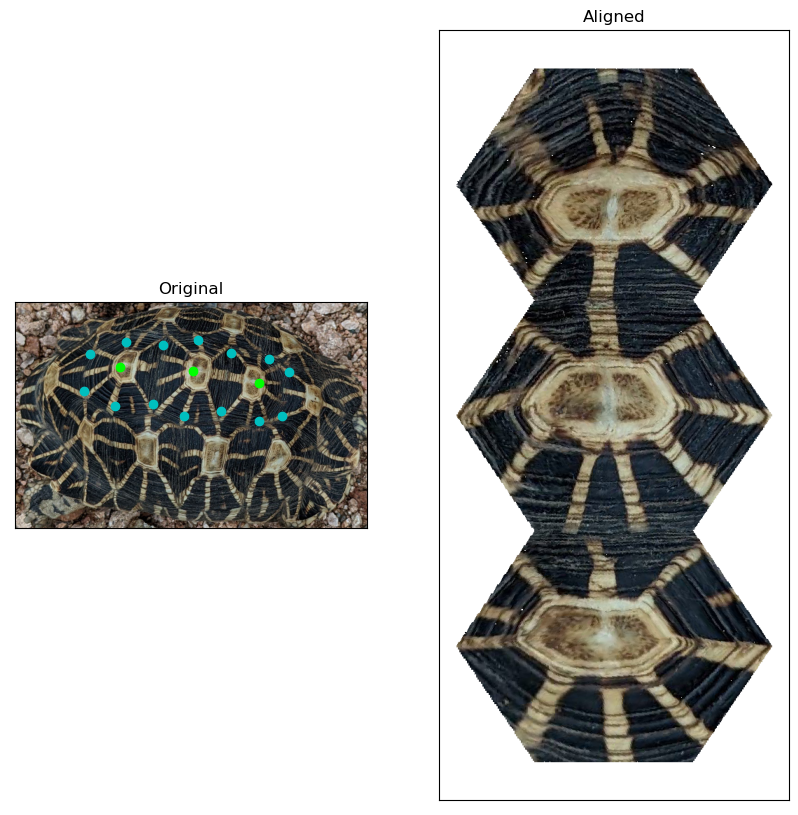

1/1 [==============================] - 0s 19ms/step


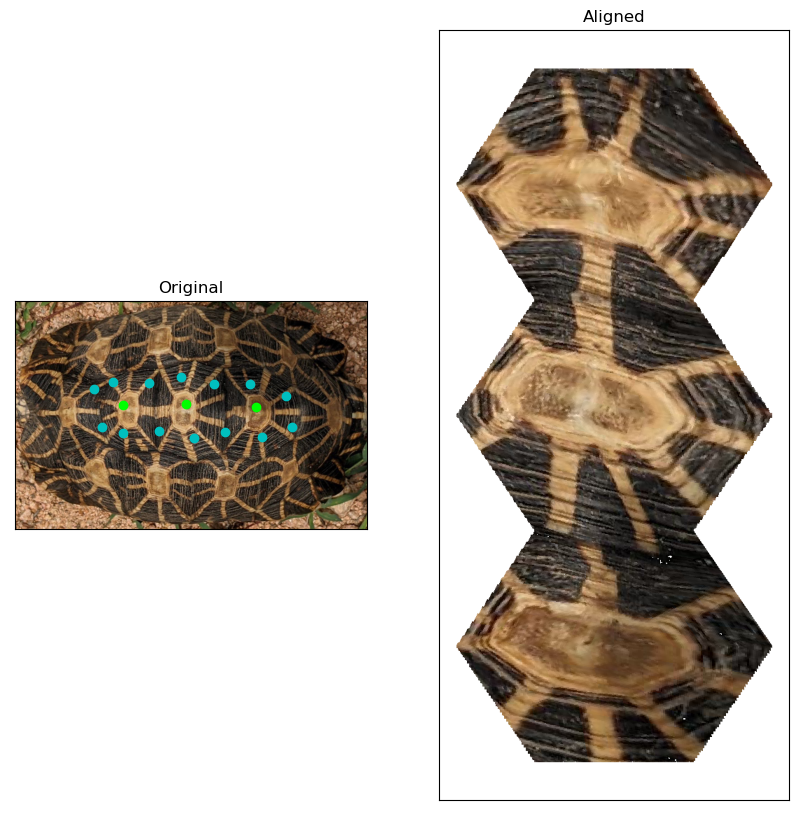

1/1 [==============================] - 0s 20ms/step


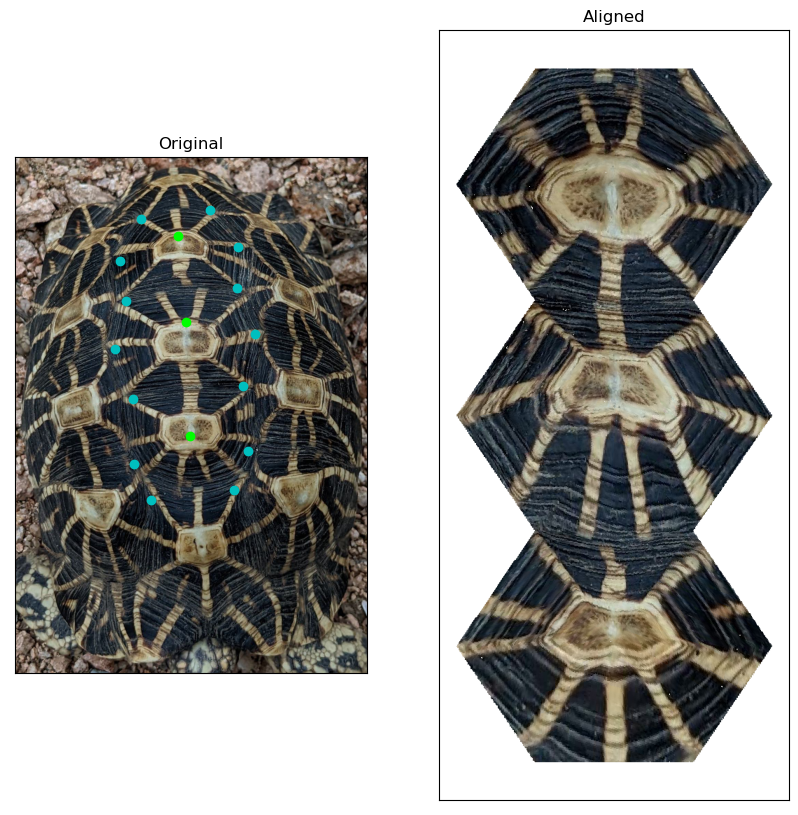

1/1 [==============================] - 0s 18ms/step


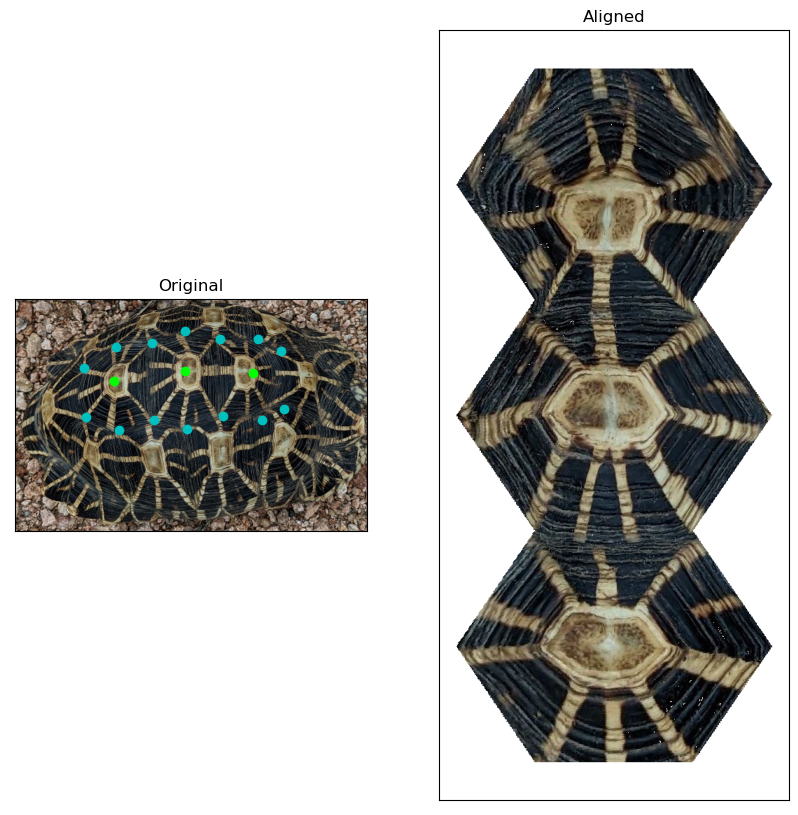

1/1 [==============================] - 0s 21ms/step


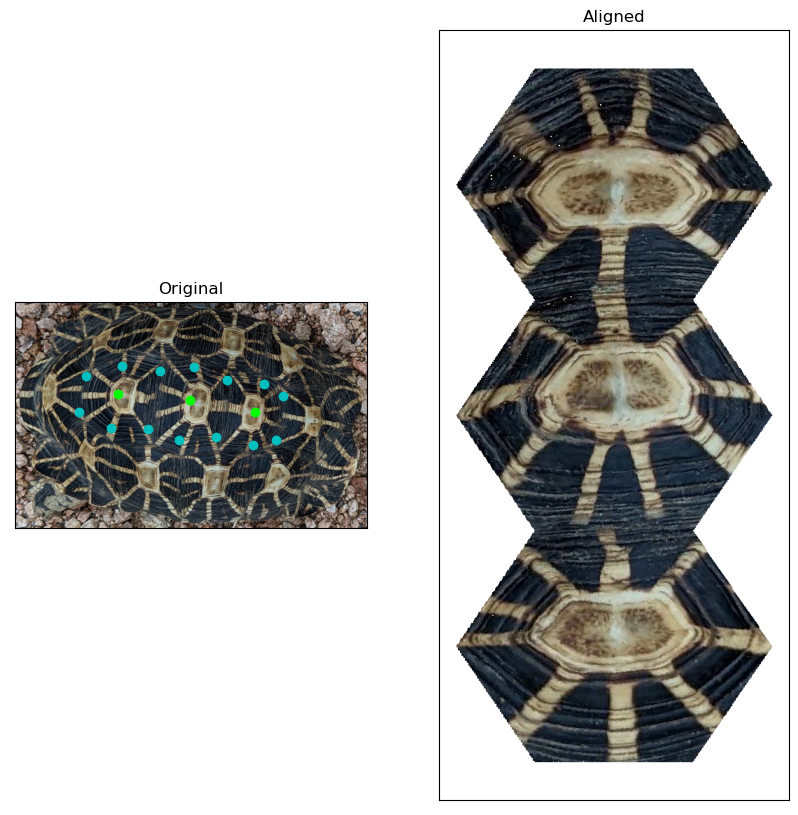

1/1 [==============================] - 0s 19ms/step


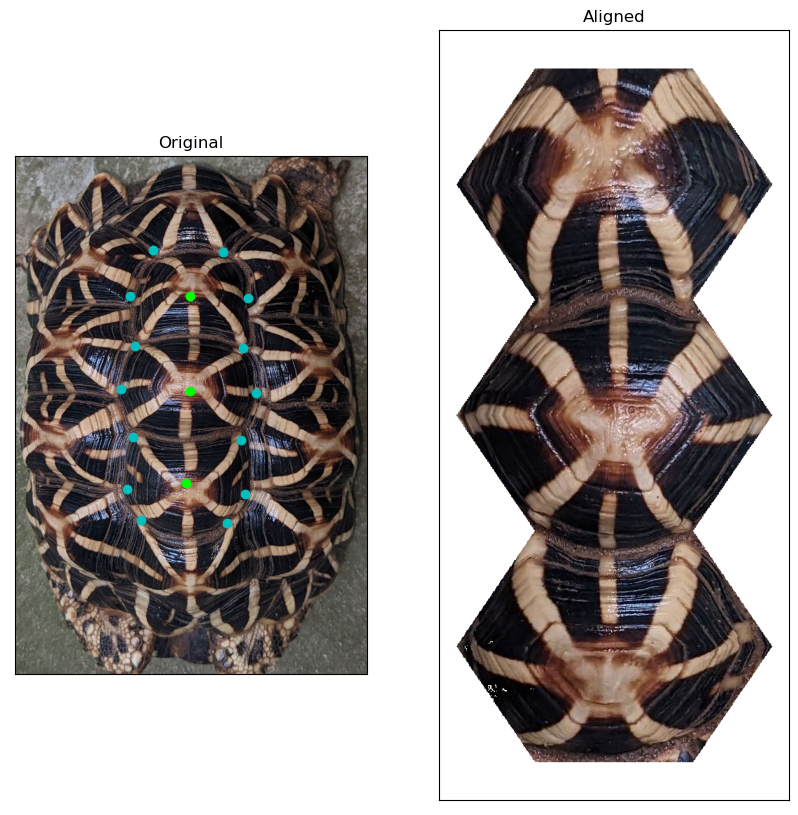

1/1 [==============================] - 0s 19ms/step


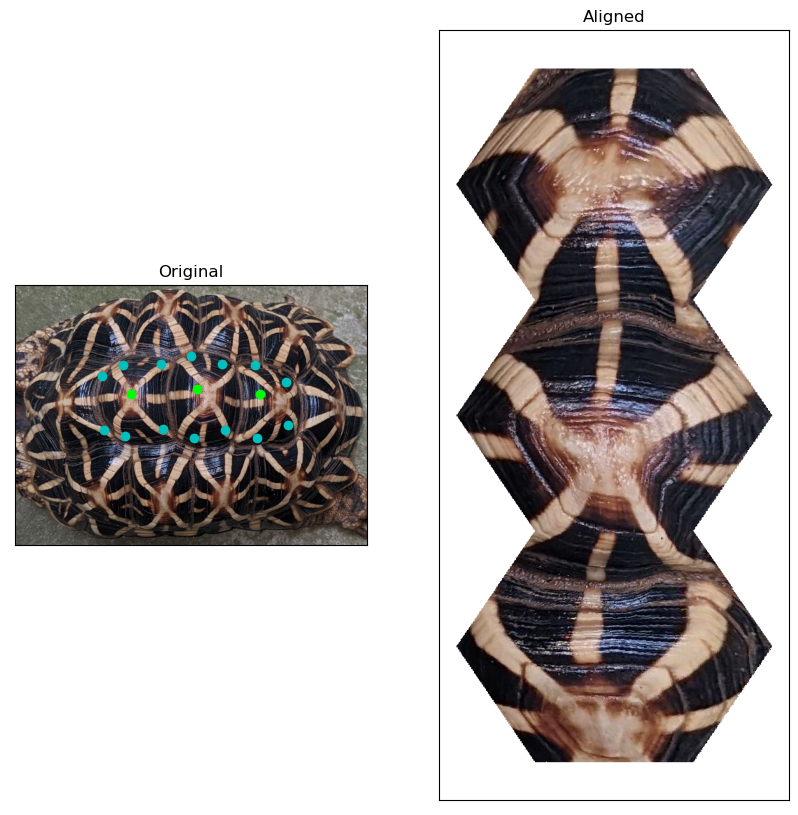

1/1 [==============================] - 0s 17ms/step


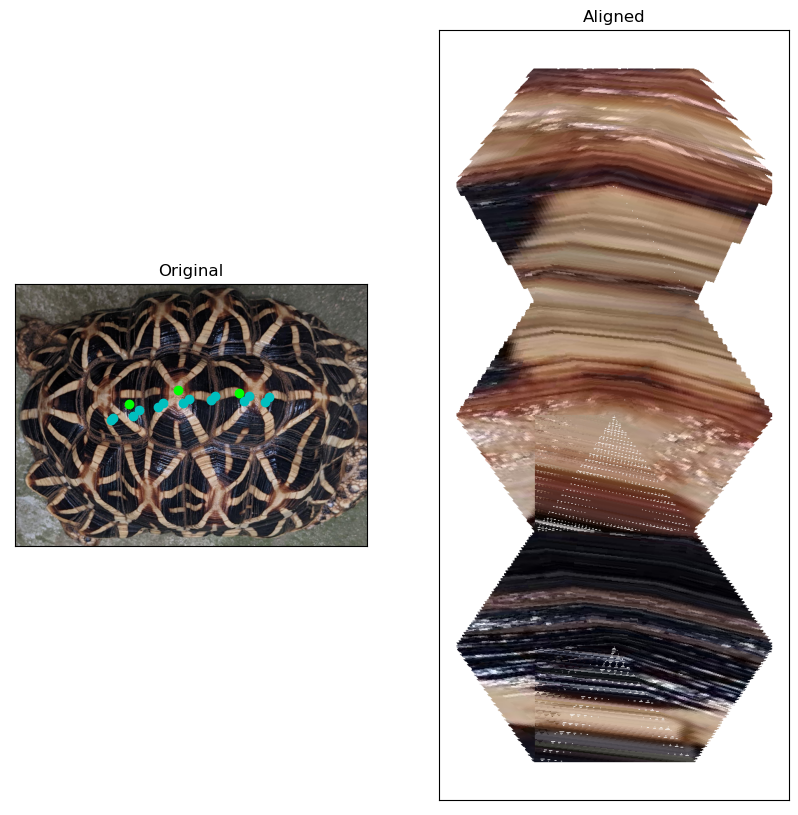

1/1 [==============================] - 0s 21ms/step


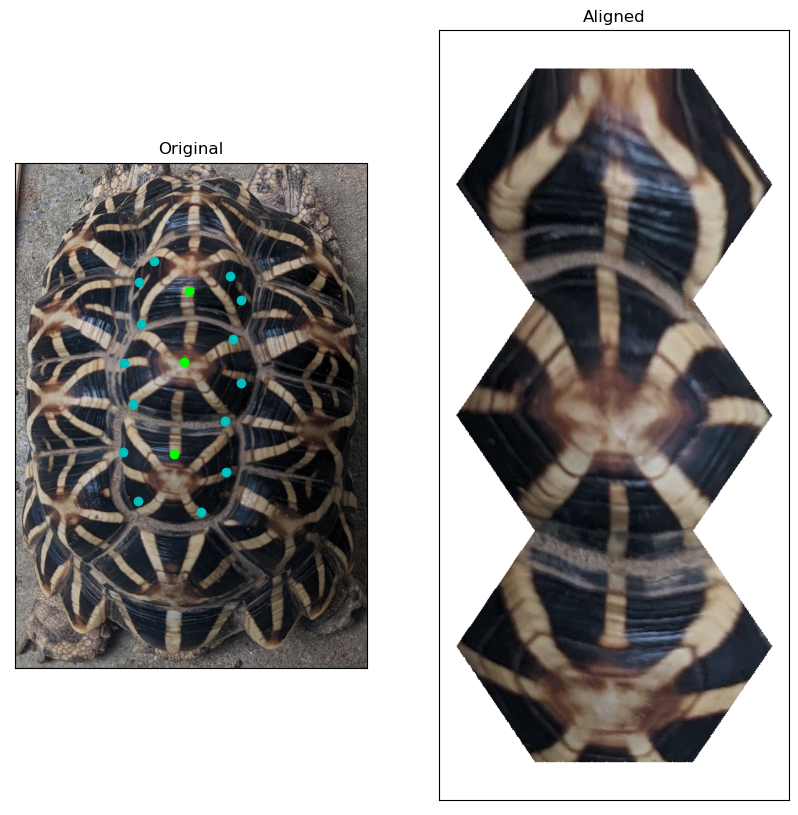

1/1 [==============================] - 0s 24ms/step


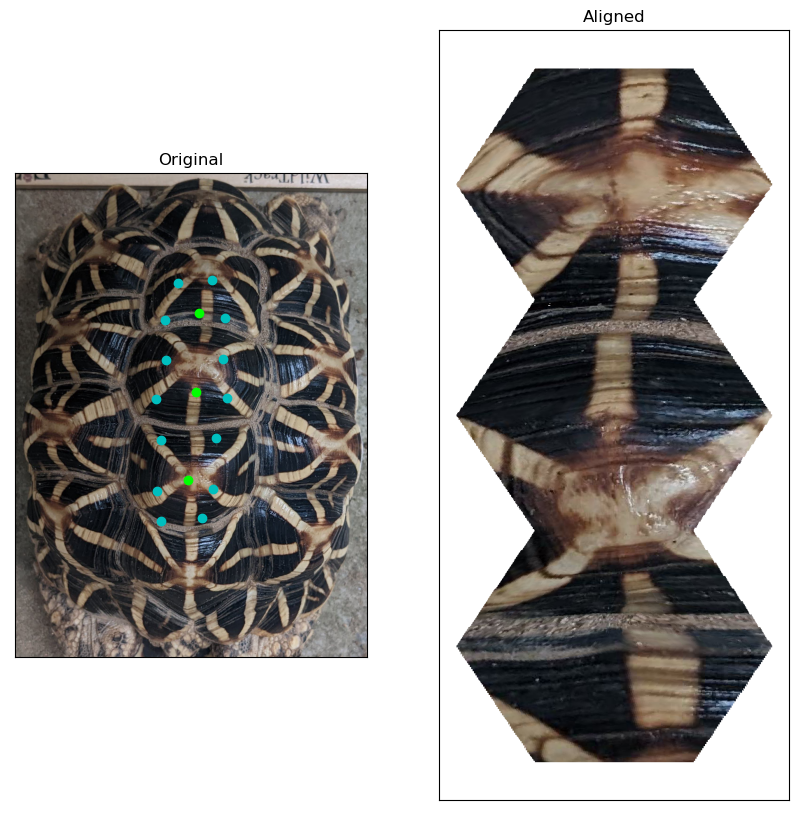

1/1 [==============================] - 0s 19ms/step


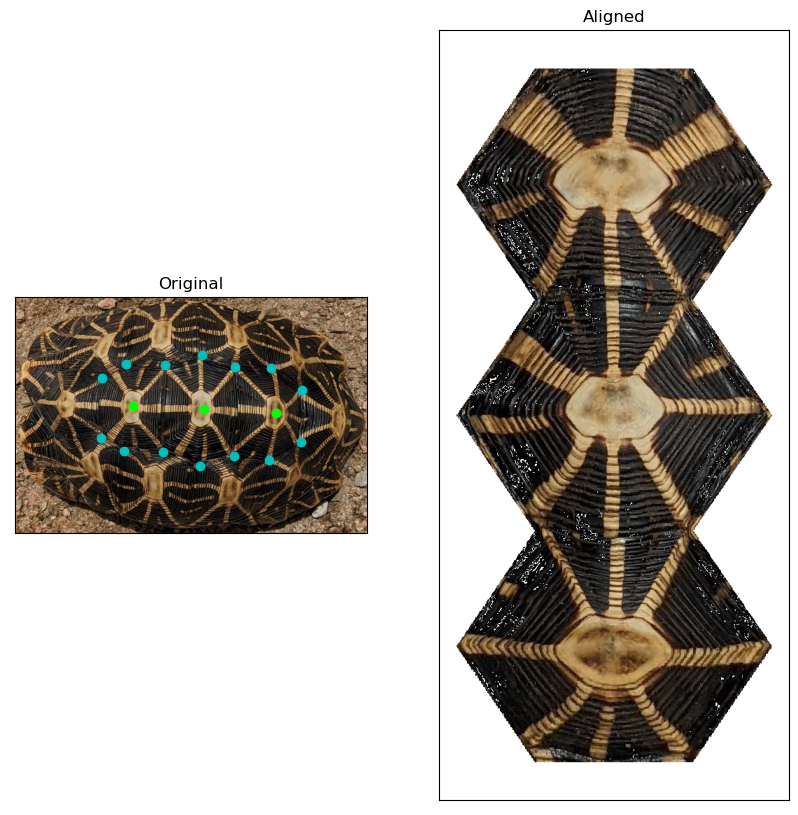

1/1 [==============================] - 0s 21ms/step


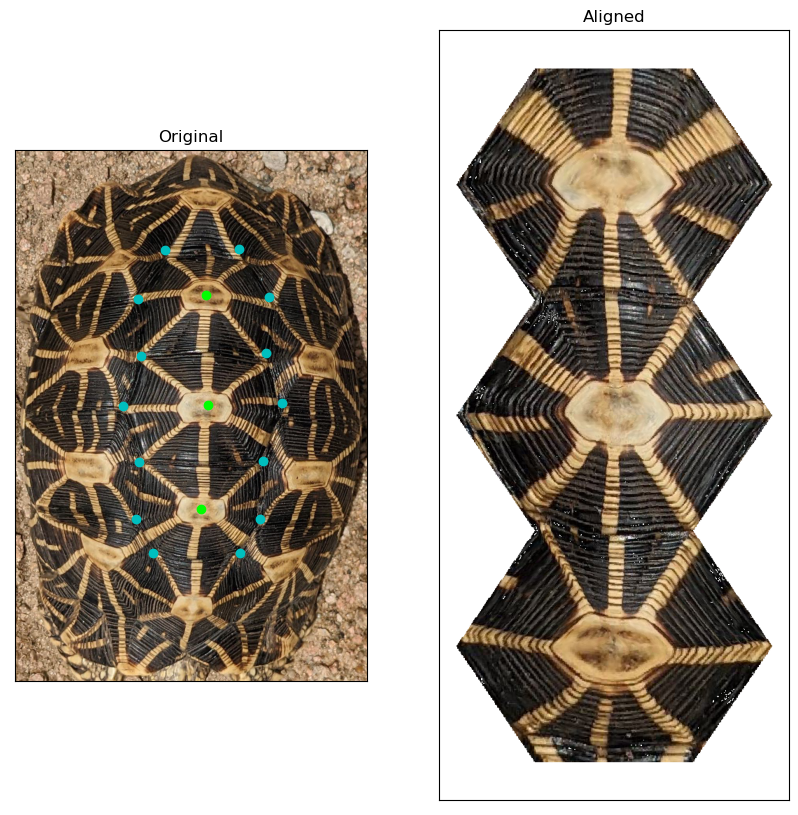

1/1 [==============================] - 0s 18ms/step


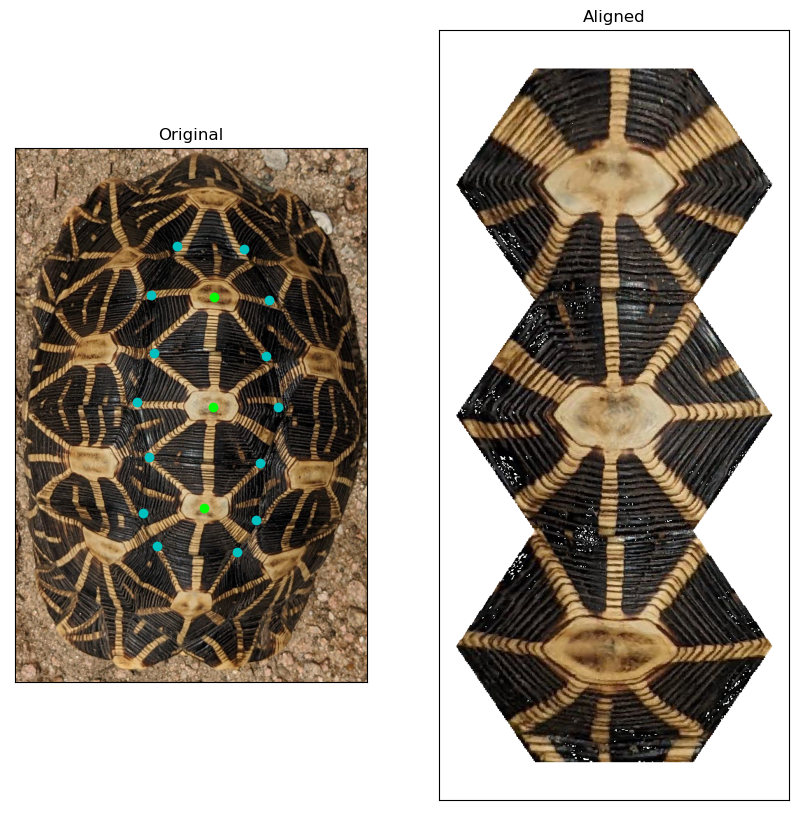

1/1 [==============================] - 0s 18ms/step


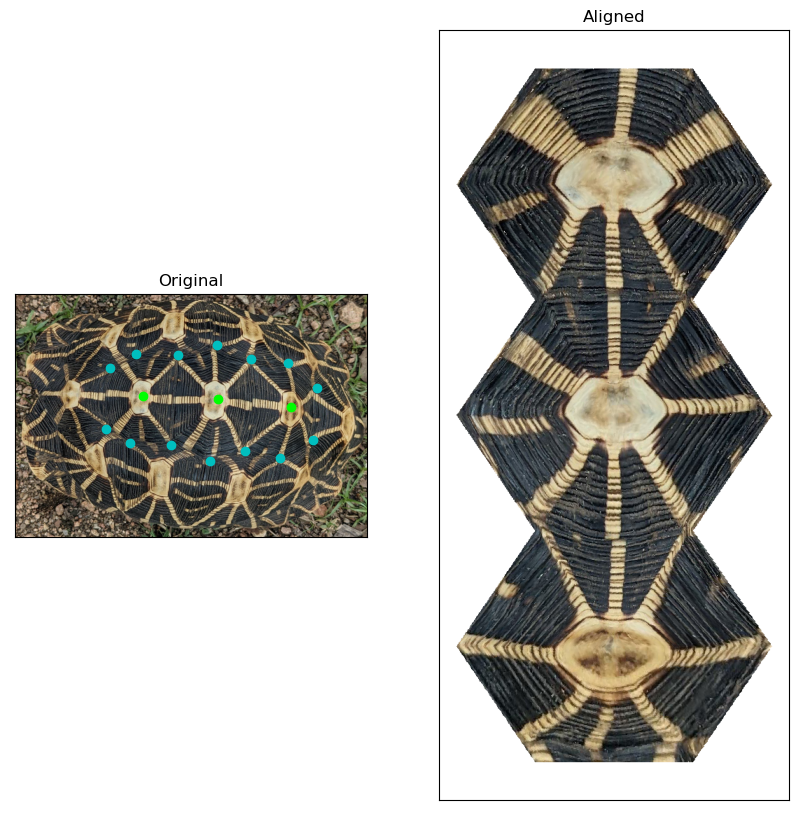

1/1 [==============================] - 0s 21ms/step


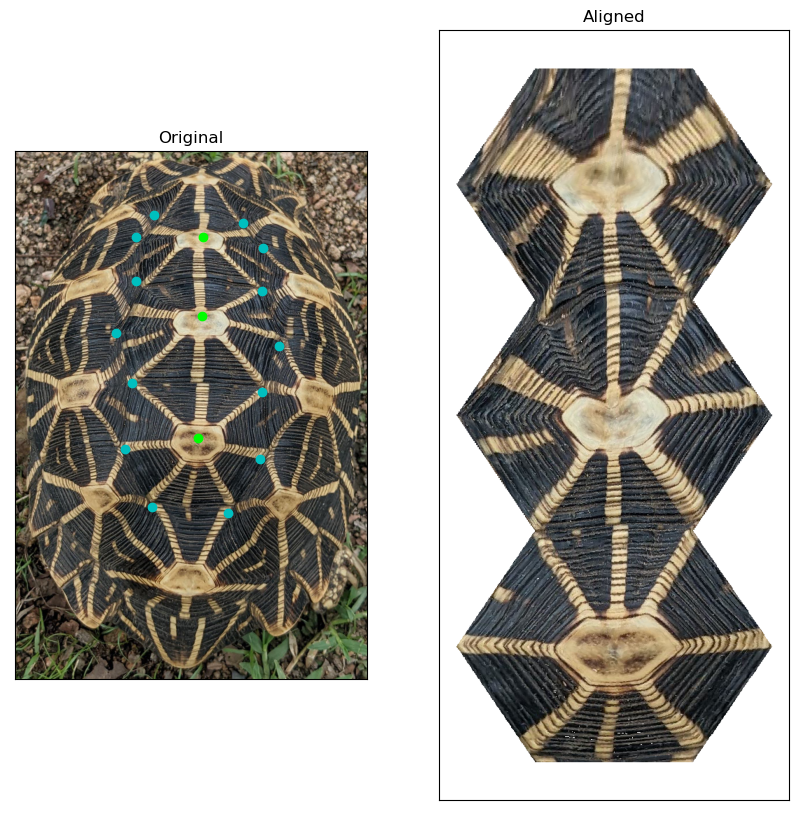

In [86]:
unseen = [os.path.join(val_dir, "2M-CCF"), os.path.join(val_dir, "7F-TVMZ") , os.path.join(test_dir, "9F-CCF")]

for directory in unseen:
    for base, _, files in os.walk(directory):
        for image_name in files:
            image = img.imread(os.path.join(base, image_name))
            resized_test_img = tf.image.resize(image, (IMAGE_SIZE, IMAGE_SIZE), method='nearest')

            test_preds = model.predict(np.expand_dims(resized_test_img, axis=0))
            
            # Plot keypoints.
            x = []
            y = []
            for coord in zip(test_preds[0, ::2], test_preds[0, 1::2]):
                x.append(int(image.shape[1] * coord[0] / resized_test_img.shape[1]))
                y.append(int(image.shape[0] * coord[1] / resized_test_img.shape[0]))
            
            corners = list(zip(x[:-3], y[:-3]))
            centers = list(zip(x[-3:], y[-3:]))
            aligned = align_scutes(image, corners, centers, TEMPLATE, (500, 1100))
            
            fig = plt.figure(figsize=(10, 10))
            axes = fig.subplots(1, 2)
            axes[0].imshow(image), axes[0].set_title('Original')
            axes[0].get_xaxis().set_visible(False), axes[0].get_yaxis().set_visible(False)
            axes[0].scatter(x[:-3], y[:-3], c='c')
            axes[0].scatter(x[-3:], y[-3:], c='lime')
            
            axes[1].imshow(aligned), axes[1].set_title('Aligned')
            axes[1].get_xaxis().set_visible(False), axes[1].get_yaxis().set_visible(False)
            
            plt.savefig(f'{image_name}.png')
            plt.show()

# Train on whole dataset minus training

In [ ]:
IMAGE_SIZE = 224
BATCH_SIZE = 32
VAL_SPLIT = 0.11
MAX_SHIFT = 20
MAX_BRIGHTNESS_DELTA = 0.2
MIN_CONTRAST = 0.5
MAX_CONTRAST = 2
MAX_HUE_DELTA = 0.1
MIN_QUALITY = 25
MAX_QUALITY = 100
MIN_SATURATION = 0.3
MAX_SATURATION = 1.7

autotune = tf.data.AUTOTUNE
raw_train_dataset = tf.data.TFRecordDataset(train_records)
raw_val_dataset = tf.data.TFRecordDataset(val_records)
raw_test_dataset = tf.data.TFRecordDataset(test_records)

train_dataset = raw_train_dataset.map(parse_tfrecord_fn, num_parallel_calls=autotune)
val_dataset = raw_val_dataset.map(parse_tfrecord_fn, num_parallel_calls=autotune)
test_dataset = raw_test_dataset.map(parse_tfrecord_fn, num_parallel_calls=autotune)

# Combine
train_val_dataset = train_dataset.concatenate(val_dataset)

# Resize
train_val_dataset = train_val_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE), num_parallel_calls=autotune)
test_dataset = test_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE), num_parallel_calls=autotune)


#  Multiply dataset by 2^n.
n = 6
for i in range(n):
    train_val_dataset = train_val_dataset.concatenate(train_val_dataset)

# Augmentations
train_val_dataset = train_val_dataset.map(flip_images_keypoints, num_parallel_calls=autotune)
train_val_dataset = train_val_dataset.map(rotate_images_keypoints, num_parallel_calls=autotune)
train_val_dataset = train_val_dataset.map(lambda x, y: shift_images_keypoints(x, y, MAX_SHIFT))
train_val_dataset = train_val_dataset.map(lambda x, y: (tf.image.random_brightness(x, MAX_BRIGHTNESS_DELTA), y))
train_val_dataset = train_val_dataset.map(lambda x, y: (tf.image.random_contrast(x, MIN_CONTRAST, MAX_CONTRAST), y))
train_val_dataset = train_val_dataset.map(lambda x, y: (tf.image.random_hue(x, MAX_HUE_DELTA), y))
train_val_dataset = train_val_dataset.map(lambda x, y: (tf.image.random_jpeg_quality(x, MIN_QUALITY, MAX_QUALITY), y))
train_val_dataset = train_val_dataset.map(lambda x, y: (tf.image.random_saturation(x, MIN_SATURATION, MAX_SATURATION), y))

train_val_dataset = train_val_dataset.shuffle(8*BATCH_SIZE)
train_val_dataset = train_val_dataset.batch(BATCH_SIZE)
train_val_dataset = train_val_dataset.prefetch(autotune)


test_dataset = test_dataset.batch(BATCH_SIZE)
test_dataset = test_dataset.prefetch(autotune)

In [ ]:
base_model = keras.applications.MobileNetV2(
    include_top=False, pooling='avg', weights='imagenet', input_shape=(224, 224, 3)
    )

# Want the last layer to be dense layer with 34 nodes
inputs = keras.Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3), name='input')
x = base_model(inputs)
x = keras.layers.Dropout(0.1)(x)
outputs = keras.layers.Dense(34)(x)
model = keras.Model(inputs, outputs)


model.summary()

In [ ]:
# mobilenetv2 training.
LEARNING_RATE = 0.001
warmup = keras.optimizers.schedules.PiecewiseConstantDecay([10*number_of_steps, 20*number_of_steps], [LEARNING_RATE/100, LEARNING_RATE/10, LEARNING_RATE])
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=warmup), 
    loss='mean_absolute_error',
    metrics=['mse'],
    )

history_high_lr=model.fit(train_val_dataset,
                  epochs=1000,
                  validation_data=test_dataset,
                  callbacks=[
                      earlystop,
                      tf.keras.callbacks.ModelCheckpoint(
                        filepath=os.path.join("high_lr", "mobilenetv2"),
                        monitor="val_loss",
                        save_best_only=True,
                        save_weights_only=True,
                        verbose=1,
                      )
                  ]
                )

model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE/100),
    loss='mean_absolute_error',
    metrics=['mse'],
    )

history_low_lr=model.fit(train_val_dataset,
                  epochs=1000,
                  validation_data=test_dataset,
                  callbacks=[
                      earlystop,
                      tf.keras.callbacks.ModelCheckpoint(
                        filepath=os.path.join("low_lr", "mobilenetv2"),
                        monitor="val_loss",
                        save_best_only=True,
                        save_weights_only=True,
                        verbose=1,
                      )
                  ]
                )